Import the dataset and read the first five rows in the dataset.

In [45]:
# The code was removed by Watson Studio for sharing.

,TYPE,YEAR,MONTH,DAY,HOUR,MINUTE,HUNDRED_BLOCK,NEIGHBOURHOOD,X,Y,Latitude,Longitude
0,Other Theft,2003,5,12,16.0,15.0,9XX TERMINAL AVE,Strathcona,493906.5,5457452.47,49.269802,-123.083763
1,Other Theft,2003,5,7,15.0,20.0,9XX TERMINAL AVE,Strathcona,493906.5,5457452.47,49.269802,-123.083763
2,Other Theft,2003,4,23,16.0,40.0,9XX TERMINAL AVE,Strathcona,493906.5,5457452.47,49.269802,-123.083763
3,Other Theft,2003,4,20,11.0,15.0,9XX TERMINAL AVE,Strathcona,493906.5,5457452.47,49.269802,-123.083763
4,Other Theft,2003,4,12,17.0,45.0,9XX TERMINAL AVE,Strathcona,493906.5,5457452.47,49.269802,-123.083763


Describe the data set 

In [46]:
df.describe(include = "all")

,TYPE,YEAR,MONTH,DAY,HOUR,MINUTE,HUNDRED_BLOCK,NEIGHBOURHOOD,X,Y,Latitude,Longitude
count,530652,530652.000000,530652.000000,530652.000000,476290.000000,476290.000000,530639,474028,530652.000000,5.306520e+05,530652.000000,530652.000000
unique,11,NaN,NaN,NaN,NaN,NaN,21204,24,NaN,NaN,NaN,NaN
top,Theft from Vehicle,NaN,NaN,NaN,NaN,NaN,OFFSET TO PROTECT PRIVACY,Central Business District,NaN,NaN,NaN,NaN
freq,172700,NaN,NaN,NaN,NaN,NaN,54362,110947,NaN,NaN,NaN,NaN
mean,NaN,2009.197956,6.450597,15.408590,13.711254,16.940039,NaN,NaN,441802.149909,4.897663e+06,44.216029,-110.495297
std,NaN,4.386272,3.399212,8.750642,6.767744,18.418950,NaN,NaN,149281.547656,1.654633e+06,14.938004,37.329862
min,NaN,2003.000000,1.000000,1.000000,0.000000,0.000000,NaN,NaN,0.000000,0.000000e+00,0.000000,-124.549757
25%,NaN,2005.000000,4.000000,8.000000,9.000000,0.000000,NaN,NaN,489944.452500,5.453651e+06,49.235573,-123.127194
50%,NaN,2009.000000,6.000000,15.000000,15.000000,10.000000,NaN,NaN,491499.240000,5.456840e+06,49.264251,-123.107128
75%,NaN,2013.000000,9.000000,23.000000,19.000000,30.000000,NaN,NaN,493547.210000,5.458638e+06,49.280441,-123.065932


In [47]:
import matplotlib.pylab as plt
import numpy as np


DATA WRANGLING : Drop rows with missing values

In [48]:
   # simply drop whole row with NaN in "NEIGHBOURHOOD" and " HUNDRED_BLOCK" columns
df.dropna(subset=["NEIGHBOURHOOD"], axis=0, inplace=True)
df.dropna(subset=["HUNDRED_BLOCK"], axis=0, inplace=True)
# reset index, because we droped  rows
df.reset_index(drop=True, inplace=True)

EXPLORATORY DATA ANALYSIS : Visualisation

In [49]:
%%capture
! pip install seaborn

In [50]:
import seaborn as sns
%matplotlib inline 

In [51]:
# list the data types for each column
print(df.dtypes)

TYPE              object
YEAR               int64
MONTH              int64
DAY                int64
HOUR             float64
MINUTE           float64
HUNDRED_BLOCK     object
NEIGHBOURHOOD     object
X                float64
Y                float64
Latitude         float64
Longitude        float64
dtype: object


Check for missing values

In [52]:

df.isnull().any().any()

False

Import libraries for visualisation

In [53]:
!conda install -c conda-forge folium=0.5.0 --yes # uncomment this line if you haven't completed the Foursquare API lab
import folium # map rendering library

Solving environment: done

# All requested packages already installed.



In [54]:
!conda install -c conda-forge squarify
import squarify

Solving environment: done

# All requested packages already installed.



Visualise Top 25 Crimes

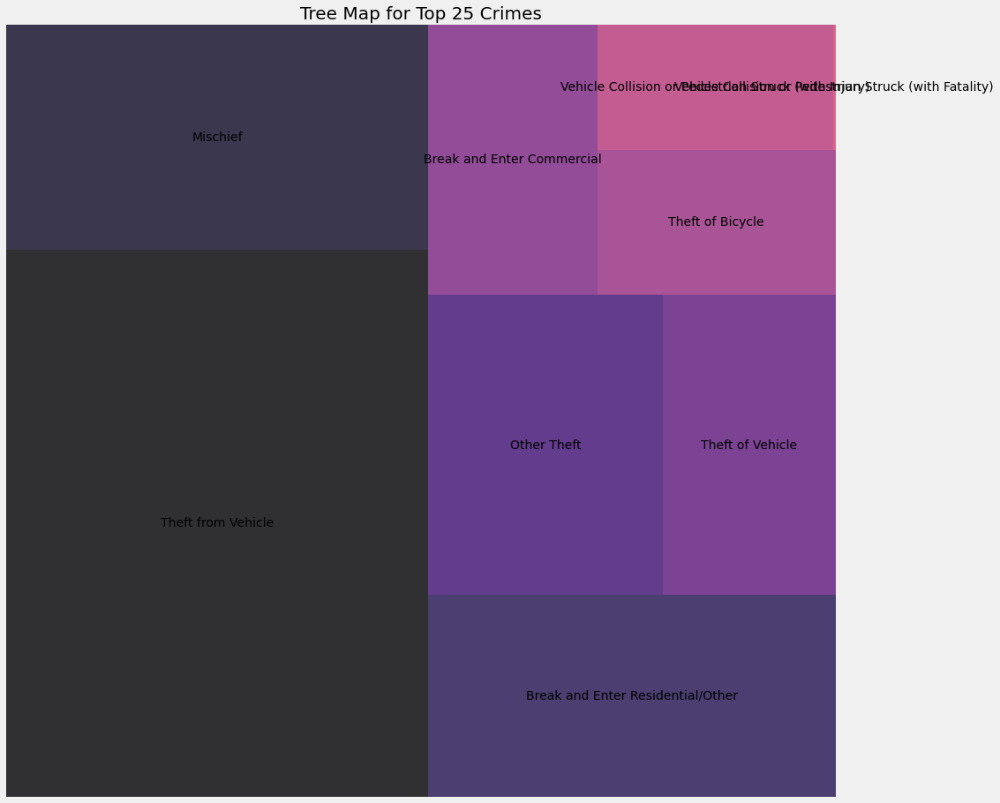

In [55]:
# plotting a tree map

y = df['TYPE'].value_counts().head(25)
    
plt.rcParams['figure.figsize'] = (15, 15)
plt.style.use('fivethirtyeight')

color = plt.cm.magma(np.linspace(0, 1, 15))
squarify.plot(sizes = y.values, label = y.index, alpha=.8, color = color)
plt.title('Tree Map for Top 25 Crimes', fontsize = 20)

plt.axis('off')
plt.show()

In [56]:
!conda install -c conda-forge wordcloud
from wordcloud import WordCloud 

Solving environment: done

# All requested packages already installed.



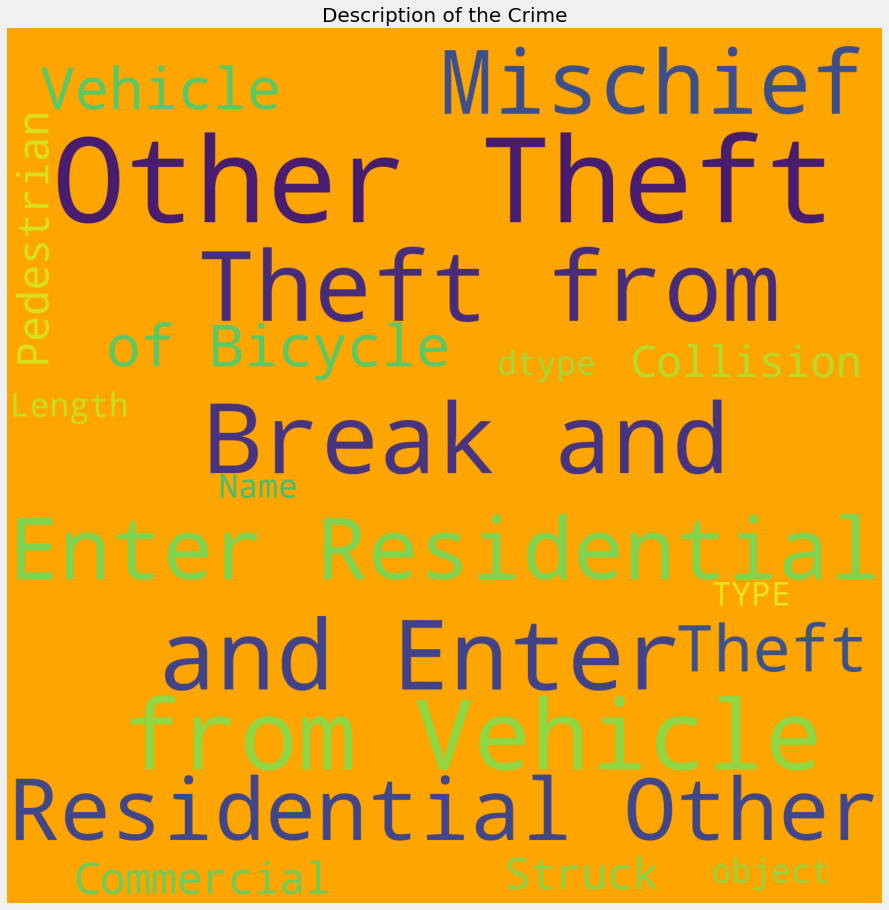

In [57]:
# description of the crime


plt.rcParams['figure.figsize'] = (15, 15)
plt.style.use('fast')

wc = WordCloud(background_color = 'orange', width = 1500, height = 1500).generate(str(df['TYPE']))
plt.title('Description of the Crime', fontsize = 20)

plt.imshow(wc)
plt.axis('off')
plt.show()

In [58]:
# install seaborn
!conda install -c anaconda seaborn --yes

# import library
import seaborn as sns

print('Seaborn installed and imported!')

Solving environment: done

## Package Plan ##

  environment location: /opt/conda/envs/Python36

  added / updated specs: 
    - seaborn


The following packages will be UPDATED:

    ca-certificates: 2020.6.20-hecda079_0     conda-forge --> 2020.6.24-0       anaconda
    certifi:         2020.6.20-py36h9f0ad1d_0 conda-forge --> 2020.6.20-py36_0  anaconda
    openssl:         1.1.1g-h516909a_0        conda-forge --> 1.1.1g-h7b6447c_0 anaconda

Preparing transaction: done
Verifying transaction: done
Executing transaction: done
Seaborn installed and imported!


In [59]:
%matplotlib inline

import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches # needed for waffle Charts

mpl.style.use('ggplot') # optional: for ggplot-like style

# check for latest version of Matplotlib
print ('Matplotlib version: ', mpl.__version__) # >= 2.0.0

Matplotlib version:  3.2.1


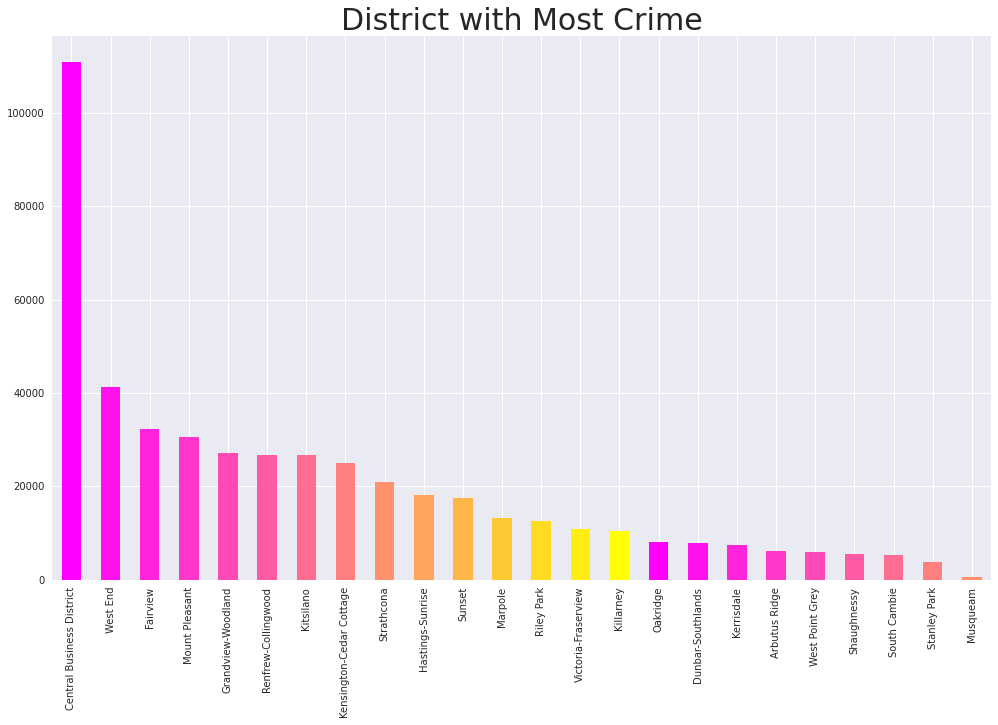

In [60]:
# Regions with count of crimes

plt.rcParams['figure.figsize'] = (20, 9)
plt.style.use('seaborn')

color = plt.cm.spring(np.linspace(0, 1, 15))
df['NEIGHBOURHOOD'].value_counts().plot.bar(color = color, figsize = (15, 10))

plt.title('District with Most Crime',fontsize = 30)

plt.xticks(rotation = 90)
plt.show()

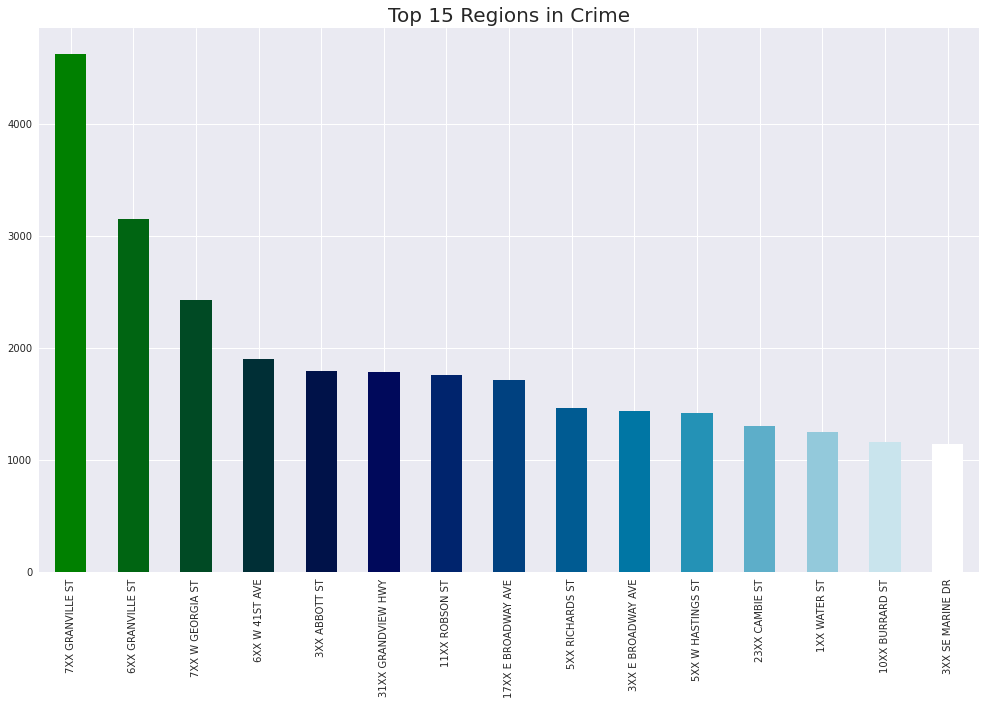

In [61]:
# Regions with count of crimes

plt.rcParams['figure.figsize'] = (20, 9)
plt.style.use('seaborn')

color = plt.cm.ocean(np.linspace(0, 1, 15))
df['HUNDRED_BLOCK'].value_counts().head(15).plot.bar(color = color, figsize = (15, 10))

plt.title('Top 15 Regions in Crime',fontsize = 20)

plt.xticks(rotation = 90)
plt.show()

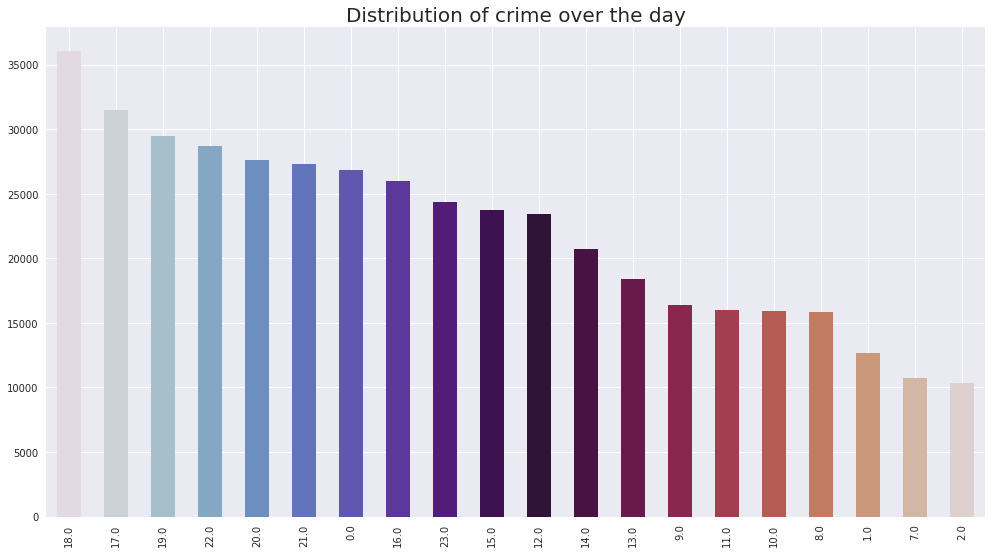

In [62]:
# checking the time at which crime occurs mostly

import warnings
warnings.filterwarnings('ignore')

color = plt.cm.twilight(np.linspace(0, 5, 100))
df['HOUR'].value_counts().head(20).plot.bar(color = color, figsize = (15, 9))

plt.title('Distribution of crime over the day', fontsize = 20)
plt.show()

In [63]:
t = df.NEIGHBOURHOOD.value_counts()

table = pd.DataFrame(data=t.values, index=t.index, columns=['Count'])
#table = table.reindex(["CENTRAL", "NORTHERN", "PARK", "SOUTHERN", "MISSION", "TENDERLOIN", "RICHMOND", "TARAVAL", "INGLESIDE", "BAYVIEW"])

table = table.reset_index()
table.rename({'index': 'Neighborhood'}, axis='columns', inplace=True)

table

,Neighborhood,Count
0,Central Business District,110945
1,West End,41352
2,Fairview,32161
3,Mount Pleasant,30534
4,Grandview-Woodland,27180
5,Renfrew-Collingwood,26761
6,Kitsilano,26698
7,Kensington-Cedar Cottage,24941
8,Strathcona,20917
9,Hastings-Sunrise,18126


In [64]:

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)


!conda install -c conda-forge geopy --yes # uncomment this line if you haven't completed the Foursquare API lab
from geopy.geocoders import Nominatim # convert an address into latitude and longitude values

# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors

# import k-means from clustering stage
from sklearn.cluster import KMeans


print('Libraries imported.')

Solving environment: done

## Package Plan ##

  environment location: /opt/conda/envs/Python36

  added / updated specs: 
    - geopy


The following packages will be UPDATED:

    certifi:         2020.6.20-py36_0  anaconda --> 2020.6.20-py36h9f0ad1d_0 conda-forge
    openssl:         1.1.1g-h7b6447c_0 anaconda --> 1.1.1g-h516909a_0        conda-forge

The following packages will be DOWNGRADED:

    ca-certificates: 2020.6.24-0       anaconda --> 2020.6.20-hecda079_0     conda-forge

Preparing transaction: done
Verifying transaction: done
Executing transaction: done
Libraries imported.


In [65]:
address = 'Vancouver'

geolocator = Nominatim(user_agent="ny_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of Vancouver city are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of Vancouver city are 49.2608724, -123.1139529.


In [66]:
from folium.plugins import MarkerCluster
from folium import plugins
from folium.plugins import FastMarkerCluster
from folium.plugins import HeatMap
from scipy.stats import pearsonr

In [67]:
Long=-123.1139529
Lat=49.2608724
locations = list(zip(df.Latitude, df.Longitude))

map1 = folium.Map(location=[Lat,Long], zoom_start=9)
FastMarkerCluster(data=locations).add_to(map1)
map1

Scatter Plot to Show the neighbourhood group based on the latitude and longitude

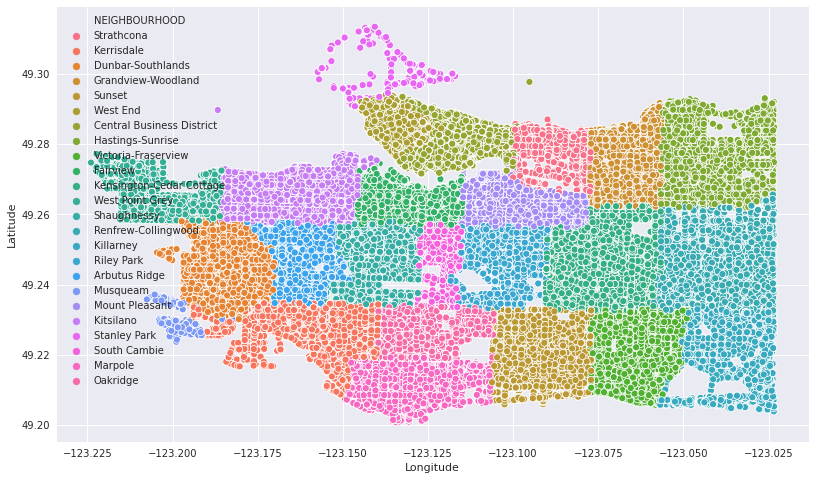

In [68]:
plt.figure(figsize=(12,8))
sns.scatterplot(x=df.Longitude,y=df.Latitude,hue=df.NEIGHBOURHOOD)
plt.show()

In [69]:
df.groupby('NEIGHBOURHOOD').count()

,TYPE,YEAR,MONTH,DAY,HOUR,MINUTE,HUNDRED_BLOCK,X,Y,Latitude,Longitude
NEIGHBOURHOOD,,,,,,,,,,,
Arbutus Ridge,6066,6066,6066,6066,6066,6066,6066,6066,6066,6066,6066
Central Business District,110945,110945,110945,110945,110945,110945,110945,110945,110945,110945,110945
Dunbar-Southlands,7746,7746,7746,7746,7746,7746,7746,7746,7746,7746,7746
Fairview,32161,32161,32161,32161,32161,32161,32161,32161,32161,32161,32161
Grandview-Woodland,27180,27180,27180,27180,27180,27180,27180,27180,27180,27180,27180
Hastings-Sunrise,18126,18126,18126,18126,18126,18126,18126,18126,18126,18126,18126
Kensington-Cedar Cottage,24941,24941,24941,24941,24941,24941,24941,24941,24941,24941,24941
Kerrisdale,7447,7447,7447,7447,7447,7447,7447,7447,7447,7447,7447
Killarney,10475,10475,10475,10475,10475,10475,10475,10475,10475,10475,10475


In [70]:
print('There are {} uniques categories.'.format(len(df['TYPE'].unique())))

There are 9 uniques categories.


In [71]:
# one hot encoding
vancouver_onehot = pd.get_dummies(df[['TYPE']], prefix="", prefix_sep="")

# add neighborhood column back to dataframe
vancouver_onehot['Neighbourhood'] = df['NEIGHBOURHOOD'] 

# move neighborhood column to the first column
fixed_columns = [vancouver_onehot.columns[-1]] + list(vancouver_onehot.columns[:-1])
vancouver_onehot = vancouver_onehot[fixed_columns]

vancouver_onehot.head()

,Neighbourhood,Break and Enter Commercial,Break and Enter Residential/Other,Mischief,Other Theft,Theft from Vehicle,Theft of Bicycle,Theft of Vehicle,Vehicle Collision or Pedestrian Struck (with Fatality),Vehicle Collision or Pedestrian Struck (with Injury)
0,Strathcona,0,0,0,1,0,0,0,0,0
1,Strathcona,0,0,0,1,0,0,0,0,0
2,Strathcona,0,0,0,1,0,0,0,0,0
3,Strathcona,0,0,0,1,0,0,0,0,0
4,Strathcona,0,0,0,1,0,0,0,0,0


In [72]:
vancouver_onehot.shape

(474015, 10)

#### Next, let's group rows by neighborhood and by taking the mean of the frequency of occurrence of each category

In [73]:
vancouver_grouped = vancouver_onehot.groupby('Neighbourhood').mean().reset_index()
vancouver_grouped

,Neighbourhood,Break and Enter Commercial,Break and Enter Residential/Other,Mischief,Other Theft,Theft from Vehicle,Theft of Bicycle,Theft of Vehicle,Vehicle Collision or Pedestrian Struck (with Fatality),Vehicle Collision or Pedestrian Struck (with Injury)
0,Arbutus Ridge,0.053577,0.275635,0.153973,0.055556,0.305308,0.026377,0.082097,0.000495,0.046983
1,Central Business District,0.084465,0.031592,0.150264,0.173446,0.432674,0.062256,0.036198,0.000370,0.028735
2,Dunbar-Southlands,0.037955,0.238446,0.170927,0.031113,0.374258,0.030984,0.081203,0.000387,0.034728
3,Fairview,0.102702,0.119213,0.099375,0.101645,0.371071,0.105532,0.063338,0.000435,0.036690
4,Grandview-Woodland,0.076600,0.166115,0.182855,0.092274,0.270125,0.051619,0.114459,0.000331,0.045622
5,Hastings-Sunrise,0.051252,0.176487,0.160212,0.076079,0.311928,0.017709,0.135275,0.000993,0.070065
6,Kensington-Cedar Cottage,0.051201,0.165831,0.150756,0.118720,0.299667,0.034441,0.117036,0.000441,0.061906
7,Kerrisdale,0.043776,0.245199,0.140862,0.035585,0.376662,0.024037,0.073452,0.000940,0.059487
8,Killarney,0.028831,0.203341,0.168115,0.023389,0.380907,0.015561,0.124296,0.001146,0.054415
9,Kitsilano,0.078358,0.164432,0.138288,0.064761,0.333808,0.092292,0.088621,0.000487,0.038954


New size

In [74]:
vancouver_grouped.shape

(24, 10)

Let's print each neighborhood along with the top 5 most common crimes

In [75]:
num_top_crimes = 5

for hood in vancouver_grouped['Neighbourhood']:
    print("----"+hood+"----")
    temp = vancouver_grouped[vancouver_grouped['Neighbourhood'] == hood].T.reset_index()
    temp.columns = ['Type','freq']
    temp = temp.iloc[1:]
    temp['freq'] = temp['freq'].astype(float)
    temp = temp.round({'freq': 2})
    print(temp.sort_values('freq', ascending=False).reset_index(drop=True).head(num_top_crimes))
    print('\n')

----Arbutus Ridge----
                                Type  freq
0                 Theft from Vehicle  0.31
1  Break and Enter Residential/Other  0.28
2                           Mischief  0.15
3                   Theft of Vehicle  0.08
4                        Other Theft  0.06


----Central Business District----
                         Type  freq
0          Theft from Vehicle  0.43
1                 Other Theft  0.17
2                    Mischief  0.15
3  Break and Enter Commercial  0.08
4            Theft of Bicycle  0.06


----Dunbar-Southlands----
                                Type  freq
0                 Theft from Vehicle  0.37
1  Break and Enter Residential/Other  0.24
2                           Mischief  0.17
3                   Theft of Vehicle  0.08
4         Break and Enter Commercial  0.04


----Fairview----
                                Type  freq
0                 Theft from Vehicle  0.37
1  Break and Enter Residential/Other  0.12
2                   Theft of Bicyc

Sort the crimes in descending order

In [76]:
def return_most_common_crimes(row, num_top_crimes):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_crimes]

Now let's create the new dataframe and display the top 10 crimes for each neighborhood

In [77]:
num_top_crimes = 9

indicators = ['st', 'nd', 'rd']

# create columns according to number of top crimes
columns = ['Neighbourhood']
for ind in np.arange(num_top_crimes):
    try:
        columns.append('{}{} Most Common Crime'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Crime'.format(ind+1))

# create a new dataframe
neighbourhoods_crimes_sorted = pd.DataFrame(columns=columns)
neighbourhoods_crimes_sorted['Neighbourhood'] = vancouver_grouped['Neighbourhood']

for ind in np.arange(vancouver_grouped.shape[0]):
    neighbourhoods_crimes_sorted.iloc[ind, 1:] = return_most_common_crimes(vancouver_grouped.iloc[ind, :], num_top_crimes)

neighbourhoods_crimes_sorted.head()

,Neighbourhood,1st Most Common Crime,2nd Most Common Crime,3rd Most Common Crime,4th Most Common Crime,5th Most Common Crime,6th Most Common Crime,7th Most Common Crime,8th Most Common Crime,9th Most Common Crime
0,Arbutus Ridge,Theft from Vehicle,Break and Enter Residential/Other,Mischief,Theft of Vehicle,Other Theft,Break and Enter Commercial,Vehicle Collision or Pedestrian Struck (with I...,Theft of Bicycle,Vehicle Collision or Pedestrian Struck (with F...
1,Central Business District,Theft from Vehicle,Other Theft,Mischief,Break and Enter Commercial,Theft of Bicycle,Theft of Vehicle,Break and Enter Residential/Other,Vehicle Collision or Pedestrian Struck (with I...,Vehicle Collision or Pedestrian Struck (with F...
2,Dunbar-Southlands,Theft from Vehicle,Break and Enter Residential/Other,Mischief,Theft of Vehicle,Break and Enter Commercial,Vehicle Collision or Pedestrian Struck (with I...,Other Theft,Theft of Bicycle,Vehicle Collision or Pedestrian Struck (with F...
3,Fairview,Theft from Vehicle,Break and Enter Residential/Other,Theft of Bicycle,Break and Enter Commercial,Other Theft,Mischief,Theft of Vehicle,Vehicle Collision or Pedestrian Struck (with I...,Vehicle Collision or Pedestrian Struck (with F...
4,Grandview-Woodland,Theft from Vehicle,Mischief,Break and Enter Residential/Other,Theft of Vehicle,Other Theft,Break and Enter Commercial,Theft of Bicycle,Vehicle Collision or Pedestrian Struck (with I...,Vehicle Collision or Pedestrian Struck (with F...


CLUSTERING: Clustering the neighbourhoods based on the type of crime 

In [78]:
# import k-means from clustering stage
from sklearn.cluster import KMeans

In [79]:
# set number of clusters
kclusters = 5

vancouver_grouped_clustering = vancouver_grouped.drop('Neighbourhood', 1)

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(vancouver_grouped_clustering)

# check cluster labels generated for each row in the dataframe
kmeans.labels_[0:10] 

array([3, 1, 3, 4, 0, 0, 0, 3, 3, 4], dtype=int32)

Let's create a new dataframe that includes the cluster as well as the top 10 venues for each neighborhood.

In [80]:
# add clustering labels
neighbourhoods_crimes_sorted.insert(0, 'Cluster Labels', kmeans.labels_)

vancouver_merged = df

# merge toronto_grouped with toronto_data to add latitude/longitude for each neighborhood
vancouver_merged = vancouver_merged.join(neighbourhoods_crimes_sorted.set_index('Neighbourhood'), on='NEIGHBOURHOOD')

vancouver_merged.head() # check the last columns!

,TYPE,YEAR,MONTH,DAY,HOUR,MINUTE,HUNDRED_BLOCK,NEIGHBOURHOOD,X,Y,Latitude,Longitude,Cluster Labels,1st Most Common Crime,2nd Most Common Crime,3rd Most Common Crime,4th Most Common Crime,5th Most Common Crime,6th Most Common Crime,7th Most Common Crime,8th Most Common Crime,9th Most Common Crime
0,Other Theft,2003,5,12,16.0,15.0,9XX TERMINAL AVE,Strathcona,493906.5,5457452.47,49.269802,-123.083763,4,Theft from Vehicle,Mischief,Break and Enter Commercial,Break and Enter Residential/Other,Theft of Vehicle,Vehicle Collision or Pedestrian Struck (with I...,Theft of Bicycle,Other Theft,Vehicle Collision or Pedestrian Struck (with F...
1,Other Theft,2003,5,7,15.0,20.0,9XX TERMINAL AVE,Strathcona,493906.5,5457452.47,49.269802,-123.083763,4,Theft from Vehicle,Mischief,Break and Enter Commercial,Break and Enter Residential/Other,Theft of Vehicle,Vehicle Collision or Pedestrian Struck (with I...,Theft of Bicycle,Other Theft,Vehicle Collision or Pedestrian Struck (with F...
2,Other Theft,2003,4,23,16.0,40.0,9XX TERMINAL AVE,Strathcona,493906.5,5457452.47,49.269802,-123.083763,4,Theft from Vehicle,Mischief,Break and Enter Commercial,Break and Enter Residential/Other,Theft of Vehicle,Vehicle Collision or Pedestrian Struck (with I...,Theft of Bicycle,Other Theft,Vehicle Collision or Pedestrian Struck (with F...
3,Other Theft,2003,4,20,11.0,15.0,9XX TERMINAL AVE,Strathcona,493906.5,5457452.47,49.269802,-123.083763,4,Theft from Vehicle,Mischief,Break and Enter Commercial,Break and Enter Residential/Other,Theft of Vehicle,Vehicle Collision or Pedestrian Struck (with I...,Theft of Bicycle,Other Theft,Vehicle Collision or Pedestrian Struck (with F...
4,Other Theft,2003,4,12,17.0,45.0,9XX TERMINAL AVE,Strathcona,493906.5,5457452.47,49.269802,-123.083763,4,Theft from Vehicle,Mischief,Break and Enter Commercial,Break and Enter Residential/Other,Theft of Vehicle,Vehicle Collision or Pedestrian Struck (with I...,Theft of Bicycle,Other Theft,Vehicle Collision or Pedestrian Struck (with F...


Finally, let's visualize the resulting clusters

In [ ]:
# create map
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=11)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(vancouver_merged['Latitude'], vancouver_merged['Longitude'], vancouver_merged['NEIGHBOURHOOD'], vancouver_merged['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_clusters)
       
map_clusters